<a href="https://www.kaggle.com/code/babaksh/vehicle-detection-yolo11?scriptVersionId=261702115" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

# Vehicle Detection using YOLOv11
# A comprehensive notebook for detecting vehicles using YOLOv11

# Vehicle Detection with YOLOv11

This notebook demonstrates how to train a YOLOv11 model for vehicle detection using a custom dataset.
We'll detect 5 types of vehicles:
- Ambulance
- Bus
- Car
- Motorcycle
- Truck

## Dataset Information
- **Total Images**: 1,254 JPG images
- **Classes**: 5 vehicle types
- **Format**: YOLO format with bounding box annotations
- **Structure**: Separate train/test/valid directories
- **Source**: Kaggle Vehicle Detection Dataset

Let's start by installing the required dependencies and setting up our environment.

In [1]:
# Install required packages
!pip install -qqq ultralytics roboflow supervision

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 26.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.7/88.7 kB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 37.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.2/207.2 kB 12.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 61.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 82.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 31.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207

In [2]:
# Import necessary libraries
import os
import cv2
import time
import yaml
import glob
import random
import shutil
import subprocess
import numpy as np
import pandas as pd
import seaborn as sns
from PIL import Image
from pathlib import Path
from collections import Counter
import matplotlib.pyplot as plt
from IPython.display import display, HTML, clear_output, Video

# Ultralytics imports
import torch
import supervision as sv
from ultralytics import YOLO

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [3]:
# Training hyperparameters
WORKERS = 2
EPOCHS = 500
PATIENCE = 20
BATCH_SIZE = 32
IMAGE_SIZE = 800
LEARNING_RATE = 0.001
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [4]:
# Set up plotting style
plt.style.use('seaborn-v0_8')
sns.set_palette("husl")

print("All packages installed successfully!")
print(f"PyTorch version: {torch.__version__}")
print(f"CUDA available: {torch.cuda.is_available()}")

All packages installed successfully!
PyTorch version: 2.6.0+cu124
CUDA available: True


# Dataset Exploration and Analysis

Before training our model, let's explore the dataset to understand:
- Dataset structure (train/test/valid splits)
- Image distribution across splits
- Class distribution  
- Image sizes and quality
- Existing YAML configuration

This will help us make informed decisions about preprocessing and training parameters.

In [5]:
# Set dataset paths
DATASET_PATH = "/kaggle/input/vehicledetection/VehiclesDetectionDataset"
TRAIN_PATH = os.path.join(DATASET_PATH, "train")
TEST_PATH = os.path.join(DATASET_PATH, "test")
VALID_PATH = os.path.join(DATASET_PATH, "valid")

In [6]:
# Define class names
CLASS_NAMES = {
    0: 'Ambulance',
    1: 'Bus',
    2: 'Car',
    3: 'Motorcycle',
    4: 'Truck'
}

print(f"Dataset path: {DATASET_PATH}")
print(f"Train path: {TRAIN_PATH}")
print(f"Test path: {TEST_PATH}")
print(f"Valid path: {VALID_PATH}")

# Check if paths exist
print(f"\nDataset exists: {os.path.exists(DATASET_PATH)}")
print(f"Train folder exists: {os.path.exists(TRAIN_PATH)}")
print(f"Test folder exists: {os.path.exists(TEST_PATH)}")
print(f"Valid folder exists: {os.path.exists(VALID_PATH)}")

Dataset path: /kaggle/input/vehicledetection/VehiclesDetectionDataset
Train path: /kaggle/input/vehicledetection/VehiclesDetectionDataset/train
Test path: /kaggle/input/vehicledetection/VehiclesDetectionDataset/test
Valid path: /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid

Dataset exists: True
Train folder exists: True
Test folder exists: True
Valid folder exists: True


In [7]:
# Look for YAML file
yaml_files = glob.glob(os.path.join(DATASET_PATH, "*.yaml"))
print(f"\nYAML files found: {yaml_files}")


YAML files found: ['/kaggle/input/vehicledetection/VehiclesDetectionDataset/dataset.yaml']


# Load and Analyze Existing YAML Configuration

Let's examine the existing YAML configuration file to understand the dataset structure.

In [8]:
# Find and load the YAML file
yaml_file_path = None
for yaml_file in yaml_files:
    yaml_file_path = yaml_file
    break

if yaml_file_path:
    print(f"Loading YAML configuration from: {yaml_file_path}")
    
    with open(yaml_file_path, 'r') as f:
        yaml_content = f.read()
        print("\nOriginal YAML content:")
        print(yaml_content)
    
    # Parse YAML
    with open(yaml_file_path, 'r') as f:
        config = yaml.safe_load(f)
        print("\nParsed configuration:")
        for key, value in config.items():
            if key != 'names':
                print(f"{key}: {value}")
        print(f"names: {config.get('names', [])}")
        
        # Update class names from YAML
        if 'names' in config:
            CLASS_NAMES = {i: name for i, name in enumerate(config['names'])}
            print(f"\nUpdated class names: {CLASS_NAMES}")
else:
    print("No YAML file found in dataset directory")

Loading YAML configuration from: /kaggle/input/vehicledetection/VehiclesDetectionDataset/dataset.yaml

Original YAML content:
train: ../train/images
val: ../valid/images
test: ../test/images

nc: 5
names: ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck']

#roboflow:
  #url: https://universe.roboflow.com/roboflow-gw7yv/vehicles-openimages/dataset/1

Parsed configuration:
train: ../train/images
val: ../valid/images
test: ../test/images
nc: 5
names: ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck']

Updated class names: {0: 'Ambulance', 1: 'Bus', 2: 'Car', 3: 'Motorcycle', 4: 'Truck'}


# Dataset Structure Analysis

Let's analyze the structure of our train, test, and validation sets.

In [9]:
def analyze_dataset_split(split_path, split_name):
    """Analyze a dataset split (train/test/valid)"""
    images_path = os.path.join(split_path, "images")
    labels_path = os.path.join(split_path, "labels")
    
    if not os.path.exists(images_path):
        print(f"Images path not found: {images_path}")
        return 0, 0
    
    # Count images
    image_files = glob.glob(os.path.join(images_path, "*.jpg"))
    num_images = len(image_files)
    
    # Count labels
    label_files = glob.glob(os.path.join(labels_path, "*.txt")) if os.path.exists(labels_path) else []
    num_labels = len(label_files)
    
    print(f"\n{split_name} Split:")
    print(f"  Images: {num_images}")
    print(f"  Labels: {num_labels}")
    print(f"  Images path: {images_path}")
    print(f"  Labels path: {labels_path}")
    
    return num_images, image_files

In [10]:
# Analyze each split
train_count, train_images = analyze_dataset_split(TRAIN_PATH, "Training")
test_count, test_images = analyze_dataset_split(TEST_PATH, "Test")
valid_count, valid_images = analyze_dataset_split(VALID_PATH, "Validation")

total_images = train_count + test_count + valid_count
print(f"\nTotal dataset summary:")
print(f"  Total images: {total_images}")
print(f"  Train: {train_count} ({train_count/total_images*100:.1f}%)")
print(f"  Test: {test_count} ({test_count/total_images*100:.1f}%)")
print(f"  Valid: {valid_count} ({valid_count/total_images*100:.1f}%)")


Training Split:
  Images: 878
  Labels: 878
  Images path: /kaggle/input/vehicledetection/VehiclesDetectionDataset/train/images
  Labels path: /kaggle/input/vehicledetection/VehiclesDetectionDataset/train/labels

Test Split:
  Images: 126
  Labels: 126
  Images path: /kaggle/input/vehicledetection/VehiclesDetectionDataset/test/images
  Labels path: /kaggle/input/vehicledetection/VehiclesDetectionDataset/test/labels

Validation Split:
  Images: 250
  Labels: 250
  Images path: /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid/images
  Labels path: /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid/labels

Total dataset summary:
  Total images: 1254
  Train: 878 (70.0%)
  Test: 126 (10.0%)
  Valid: 250 (19.9%)


# Image Size Analysis

Let's analyze the dimensions and characteristics of our images across all splits.

In [11]:
def analyze_image_sizes(image_files, sample_size=100):
    """Analyze image dimensions from a list of image files"""
    sample_files = random.sample(image_files, min(sample_size, len(image_files)))
    image_sizes = []
    
    for img_path in sample_files:
        try:
            with Image.open(img_path) as img:
                image_sizes.append(img.size)
        except Exception as e:
            print(f"Error reading {img_path}: {e}")
    
    return image_sizes

In [12]:
# Collect image sizes from all splits
all_image_files = train_images + test_images + valid_images
image_sizes = analyze_image_sizes(all_image_files, sample_size=200)

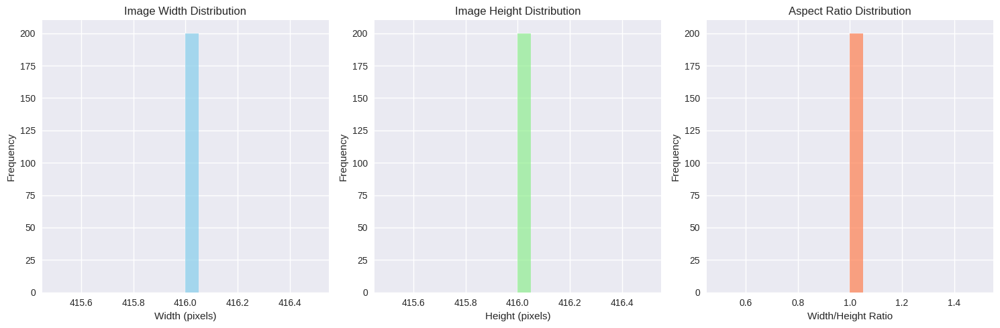

Average image size: 416 x 416
Min image size: 416 x 416
Max image size: 416 x 416
Average aspect ratio: 1.00


In [13]:
if image_sizes:
    widths, heights = zip(*image_sizes)
    
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    
    # Width distribution
    axes[0].hist(widths, bins=20, alpha=0.7, color='skyblue')
    axes[0].set_title('Image Width Distribution')
    axes[0].set_xlabel('Width (pixels)')
    axes[0].set_ylabel('Frequency')
    
    # Height distribution
    axes[1].hist(heights, bins=20, alpha=0.7, color='lightgreen')
    axes[1].set_title('Image Height Distribution')
    axes[1].set_xlabel('Height (pixels)')
    axes[1].set_ylabel('Frequency')
    
    # Aspect ratio distribution
    aspect_ratios = [w/h for w, h in zip(widths, heights)]
    axes[2].hist(aspect_ratios, bins=20, alpha=0.7, color='coral')
    axes[2].set_title('Aspect Ratio Distribution')
    axes[2].set_xlabel('Width/Height Ratio')
    axes[2].set_ylabel('Frequency')
    
    plt.tight_layout()
    plt.show()
    
    print(f"Average image size: {np.mean(widths):.0f} x {np.mean(heights):.0f}")
    print(f"Min image size: {min(widths)} x {min(heights)}")
    print(f"Max image size: {max(widths)} x {max(heights)}")
    print(f"Average aspect ratio: {np.mean(aspect_ratios):.2f}")

# Class Distribution Analysis

Let's analyze the distribution of vehicle classes across our dataset splits.

In [14]:
def analyze_class_distribution(split_path, split_name):
    """Analyze class distribution in a dataset split"""
    labels_path = os.path.join(split_path, "labels")
    
    if not os.path.exists(labels_path):
        print(f"Labels path not found: {labels_path}")
        return Counter()
    
    label_files = glob.glob(os.path.join(labels_path, "*.txt"))
    class_counts = Counter()
    total_objects = 0
    
    for label_file in label_files:
        try:
            with open(label_file, 'r') as f:
                lines = f.readlines()
                for line in lines:
                    if line.strip():
                        class_id = int(line.split()[0])
                        class_counts[class_id] += 1
                        total_objects += 1
        except Exception as e:
            print(f"Error reading {label_file}: {e}")
    
    print(f"\n{split_name} - Class distribution:")
    for class_id, count in sorted(class_counts.items()):
        class_name = CLASS_NAMES.get(class_id, f"Unknown_{class_id}")
        percentage = (count / total_objects) * 100 if total_objects > 0 else 0
        print(f"  {class_name}: {count} ({percentage:.1f}%)")
    
    return class_counts

In [15]:
# Analyze class distribution for each split
train_class_counts = analyze_class_distribution(TRAIN_PATH, "Training")
test_class_counts = analyze_class_distribution(TEST_PATH, "Test")
valid_class_counts = analyze_class_distribution(VALID_PATH, "Validation")

# Combine all class counts
total_class_counts = Counter()
for counter in [train_class_counts, test_class_counts, valid_class_counts]:
    total_class_counts.update(counter)

total_objects = sum(total_class_counts.values())
print(f"\nOverall dataset - Total annotated objects: {total_objects}")
print("Overall class distribution:")
for class_id, count in sorted(total_class_counts.items()):
    class_name = CLASS_NAMES.get(class_id, f"Unknown_{class_id}")
    percentage = (count / total_objects) * 100
    print(f"  {class_name}: {count} ({percentage:.1f}%)")


Training - Class distribution:
  Ambulance: 170 (10.1%)
  Bus: 198 (11.8%)
  Car: 914 (54.5%)
  Motorcycle: 202 (12.1%)
  Truck: 192 (11.5%)

Test - Class distribution:
  Ambulance: 18 (7.0%)
  Bus: 38 (14.7%)
  Car: 150 (58.1%)
  Motorcycle: 32 (12.4%)
  Truck: 20 (7.8%)

Validation - Class distribution:
  Ambulance: 64 (14.1%)
  Bus: 46 (10.1%)
  Car: 238 (52.4%)
  Motorcycle: 46 (10.1%)
  Truck: 60 (13.2%)

Overall dataset - Total annotated objects: 2388
Overall class distribution:
  Ambulance: 252 (10.6%)
  Bus: 282 (11.8%)
  Car: 1302 (54.5%)
  Motorcycle: 280 (11.7%)
  Truck: 272 (11.4%)


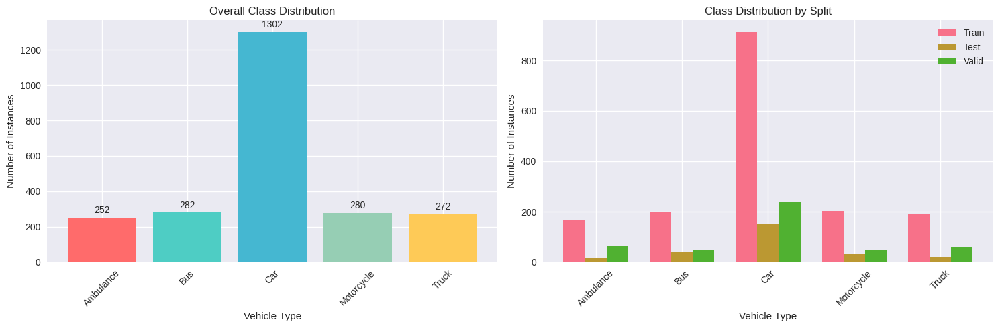

In [16]:
# Visualize class distribution
if total_class_counts:
    plt.figure(figsize=(15, 5))
    
    # Overall distribution
    plt.subplot(1, 2, 1)
    classes = [CLASS_NAMES.get(i, f"Class_{i}") for i in sorted(total_class_counts.keys())]
    counts = [total_class_counts[i] for i in sorted(total_class_counts.keys())]
    
    bars = plt.bar(classes, counts, color=['#FF6B6B', '#4ECDC4', '#45B7D1', '#96CEB4', '#FECA57'])
    plt.title('Overall Class Distribution')
    plt.xlabel('Vehicle Type')
    plt.ylabel('Number of Instances')
    plt.xticks(rotation=45)
    
    # Add value labels on bars
    for bar, count in zip(bars, counts):
        plt.text(bar.get_x() + bar.get_width()/2, bar.get_height() + max(counts)*0.01,
                str(count), ha='center', va='bottom')
    
    # Distribution by split
    plt.subplot(1, 2, 2)
    split_data = {
        'Train': [train_class_counts.get(i, 0) for i in sorted(total_class_counts.keys())],
        'Test': [test_class_counts.get(i, 0) for i in sorted(total_class_counts.keys())],
        'Valid': [valid_class_counts.get(i, 0) for i in sorted(total_class_counts.keys())]
    }
    
    x = np.arange(len(classes))
    width = 0.25
    
    for i, (split_name, split_counts) in enumerate(split_data.items()):
        plt.bar(x + i*width, split_counts, width, label=split_name)
    
    plt.title('Class Distribution by Split')
    plt.xlabel('Vehicle Type')
    plt.ylabel('Number of Instances')
    plt.xticks(x + width, classes, rotation=45)
    plt.legend()
    
    plt.tight_layout()
    plt.show()

# Sample Images Visualization

Let's visualize some sample images from our dataset with their annotations to better understand the data quality.

In [17]:
def draw_bounding_boxes(image_path, label_path, class_names):
    """Draw bounding boxes on image based on YOLO format labels"""
    # Read image
    image = cv2.imread(image_path)
    if image is None:
        return None
    
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    h, w = image.shape[:2]
    
    # Read labels
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            lines = f.readlines()
            
        for line in lines:
            if line.strip():
                parts = line.strip().split()
                class_id = int(parts[0])
                x_center = float(parts[1])
                y_center = float(parts[2])
                width = float(parts[3])
                height = float(parts[4])
                
                # Convert YOLO format to pixel coordinates
                x1 = int((x_center - width/2) * w)
                y1 = int((y_center - height/2) * h)
                x2 = int((x_center + width/2) * w)
                y2 = int((y_center + height/2) * h)
                
                # Draw bounding box
                cv2.rectangle(image, (x1, y1), (x2, y2), (255, 0, 0), 2)
                
                # Add class label
                class_name = class_names.get(class_id, f"Class_{class_id}")
                cv2.putText(image, class_name, (x1, y1-10), 
                           cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)
    
    return image

In [18]:
# Display sample images from each split
def show_sample_images(image_files, labels_dir, split_name, num_samples=4):
    """Show sample images with annotations from a split"""
    sample_images = random.sample(image_files, min(num_samples, len(image_files)))
    
    fig, axes = plt.subplots(1, num_samples, figsize=(20, 5))
    if num_samples == 1:
        axes = [axes]
    
    fig.suptitle(f'Sample Images from {split_name} Set', fontsize=16)
    
    for i, img_path in enumerate(sample_images):
        # Get corresponding label file
        img_name = os.path.splitext(os.path.basename(img_path))[0]
        label_path = os.path.join(labels_dir, f"{img_name}.txt")
        
        # Draw bounding boxes
        annotated_image = draw_bounding_boxes(img_path, label_path, CLASS_NAMES)
        
        if annotated_image is not None:
            axes[i].imshow(annotated_image)
            axes[i].set_title(f"Sample {i+1}")
            axes[i].axis('off')
        else:
            axes[i].text(0.5, 0.5, 'Image not found', ha='center', va='center')
            axes[i].set_title(f"Sample {i+1}")

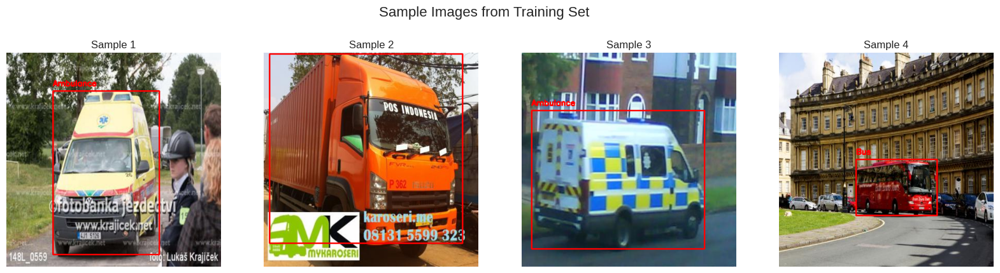

In [19]:
# Show samples from each split
if train_images:
    show_sample_images(train_images, os.path.join(TRAIN_PATH, "labels"), "Training")
    plt.show()

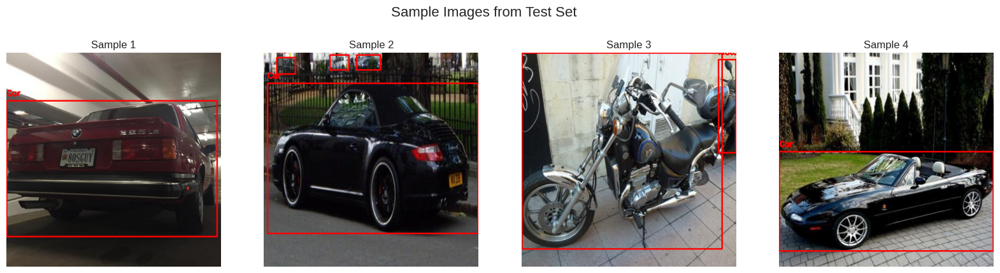

In [20]:
if test_images:
    show_sample_images(test_images, os.path.join(TEST_PATH, "labels"), "Test")
    plt.show()

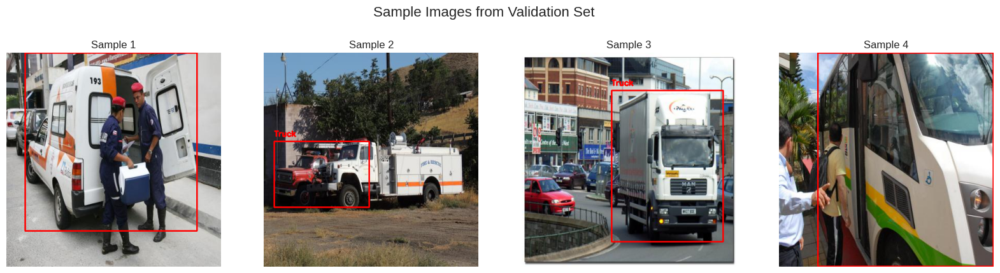

In [21]:
if valid_images:
    show_sample_images(valid_images, os.path.join(VALID_PATH, "labels"), "Validation")
    plt.show()

# Create YOLOv11 Dataset Configuration

We'll create a new YAML configuration file optimized for YOLOv11 training, using the existing dataset structure.

In [22]:
# Create YOLOv11 compatible YAML configuration
yolo11_config = {
    'path': DATASET_PATH,
    'train': 'train/images',
    'val': 'valid/images',
    'test': 'test/images',
    'nc': 5,
    'names': ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck']
}

In [23]:
# Save the configuration file
config_path = os.path.join('/kaggle/working', 'yolo11_dataset.yaml')
with open(config_path, 'w') as f:
    yaml.dump(yolo11_config, f, default_flow_style=False)

print("YOLOv11 dataset configuration created:")
print(f"Path: {config_path}")
print("\nConfiguration content:")
with open(config_path, 'r') as f:
    print(f.read())

YOLOv11 dataset configuration created:
Path: /kaggle/working/yolo11_dataset.yaml

Configuration content:
names:
- Ambulance
- Bus
- Car
- Motorcycle
- Truck
nc: 5
path: /kaggle/input/vehicledetection/VehiclesDetectionDataset
test: test/images
train: train/images
val: valid/images



# Model Initialization and Setup

Now we'll initialize our YOLOv11 model for training. We'll use transfer learning from a pre-trained model.

In [24]:
# Initialize YOLOv11 model
model = YOLO('yolo11n.pt')  # nano version for faster training

print("YOLOv11 model loaded successfully!")
print(f"Model architecture: {model.model}")

# Display model information
model.info()

YOLOv11 model loaded successfully!
Model architecture: DetectionModel(
  (model): Sequential(
    (0): Conv(
      (conv): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(16, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
      (act): SiLU(inplace=True)
    )
    (1): Conv(
      (conv): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(32, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
      (act): SiLU(inplace=True)
    )
    (2): C3k2(
      (cv1): Conv(
        (conv): Conv2d(32, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn): BatchNorm2d(32, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (cv2): Conv(
        (conv): Conv2d(48, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn): BatchNorm2d(64, eps=0.001, momentum=0.03, affine=True, track_running_st

(181, 2624080, 0, 6.614336)

# Training Configuration

Let's set up our training parameters. These can be adjusted based on your computational resources.

In [25]:
# Training configuration
training_config = {
    'data': config_path,
    'epochs': EPOCHS,
    'batch': BATCH_SIZE,
    'imgsz': IMAGE_SIZE,
    'lr0': LEARNING_RATE,
    'patience': PATIENCE,
    'save_period': 10,
    'project': '/kaggle/working',
    'name': 'vehicle_detection_yolo11',
    'device': 0 if torch.cuda.is_available() else 'cpu',
    'workers': 2,
    'plots': True,
    'verbose': True,
    'cache': False,
    'single_cls': False,
    'rect': False,
    'cos_lr': False,
    'close_mosaic': 10,
    'resume': False,
    'amp': True,
    'fraction': 1.0,
    'profile': False,
    'overlap_mask': True,
    'mask_ratio': 4,
    'dropout': 0.0,
    'val': True
}

In [26]:
print("Training Configuration:")
for key, value in training_config.items():
    print(f"{key}: {value}")

Training Configuration:
data: /kaggle/working/yolo11_dataset.yaml
epochs: 500
batch: 32
imgsz: 800
lr0: 0.001
patience: 20
save_period: 10
project: /kaggle/working
name: vehicle_detection_yolo11
device: 0
workers: 2
plots: True
verbose: True
cache: False
single_cls: False
rect: False
cos_lr: False
close_mosaic: 10
resume: False
amp: True
fraction: 1.0
profile: False
overlap_mask: True
mask_ratio: 4
dropout: 0.0
val: True


# Model Training

Now let's train our YOLOv11 model. This process will take time depending on your hardware.

The training will display:
- Loss curves (training and validation)
- Precision, Recall, and mAP metrics
- Training progress and estimated time

In [27]:
# Start training
print("Starting YOLOv11 model training...")
print("This may take a while depending on your hardware and dataset size.")
print(f"Training on device: {'GPU' if torch.cuda.is_available() else 'CPU'}")

# Train the model
results = model.train(
    data=config_path,
    epochs=EPOCHS,
    batch=BATCH_SIZE,
    imgsz=IMAGE_SIZE,
    lr0=LEARNING_RATE,
    patience=PATIENCE,
    save_period=10,
    project='/kaggle/working',
    name='vehicle_detection_yolo11',
    device=DEVICE,
    workers=WORKERS,
    plots=True,
    verbose=False,
    cache=False,
    single_cls=False,
    rect=False,
    cos_lr=False,
    close_mosaic=10,
    resume=False,
    amp=True,
    fraction=1.0,
    profile=False,
    overlap_mask=True,
    mask_ratio=4,
    dropout=0.0,
    val=True
)

Starting YOLOv11 model training...
This may take a while depending on your hardware and dataset size.
Training on device: GPU
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/working/yolo11_dataset.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=500, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=800, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=vehicle_detection_yolo11, nbs=64, nms=False, opset=None, optimize=False, optimizer=aut

                   all        250        454      0.618      0.457      0.515      0.352
Speed: 0.3ms preprocess, 3.1ms inference, 0.0ms loss, 4.5ms postprocess per image
Results saved to /kaggle/working/vehicle_detection_yolo11


# Training Results Analysis

Let's analyze the training results and visualize the performance metrics.

Training results saved to: /kaggle/working/vehicle_detection_yolo11

Generated files:
  - BoxR_curve.png
  - results.csv
  - weights
  - train_batch0.jpg
  - train_batch1.jpg
  - val_batch0_labels.jpg
  - results.png
  - val_batch0_pred.jpg
  - val_batch2_pred.jpg
  - val_batch2_labels.jpg
  - BoxPR_curve.png
  - labels.jpg
  - BoxF1_curve.png
  - confusion_matrix.png
  - args.yaml
  - BoxP_curve.png
  - confusion_matrix_normalized.png
  - train_batch2.jpg
  - val_batch1_pred.jpg
  - val_batch1_labels.jpg


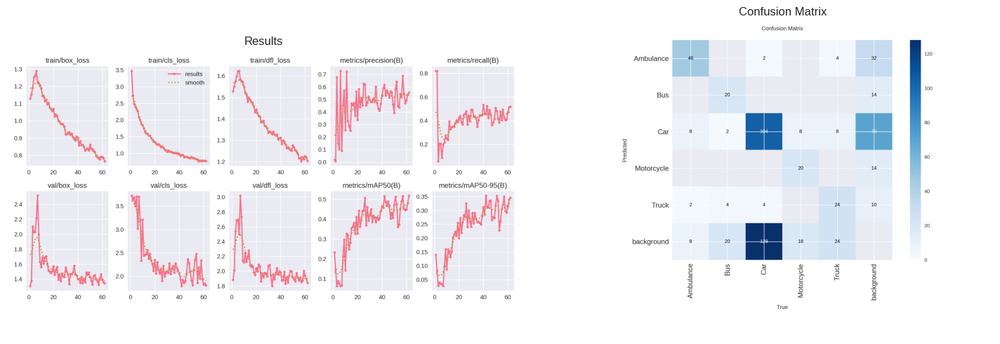

In [28]:
# Training results directory
results_path = '/kaggle/working/vehicle_detection_yolo11'

# Check if results directory exists
if os.path.exists(results_path):
    print("Training results saved to:", results_path)
    print("\nGenerated files:")
    for file in os.listdir(results_path):
        print(f"  - {file}")
    
    # Display training plots
    plot_files = ['results.png', 'confusion_matrix.png', 'F1_curve.png', 'PR_curve.png', 'P_curve.png', 'R_curve.png']
    
    # Find available plots
    available_plots = []
    for plot_file in plot_files:
        plot_path = os.path.join(results_path, plot_file)
        if os.path.exists(plot_path):
            available_plots.append((plot_file, plot_path))
    
    if available_plots:
        # Display plots in a grid
        n_plots = len(available_plots)
        cols = 2
        rows = (n_plots + 1) // 2
        
        fig, axes = plt.subplots(rows, cols, figsize=(15, 5*rows))
        if rows == 1:
            axes = axes.reshape(1, -1)
        
        for i, (plot_name, plot_path) in enumerate(available_plots):
            row = i // cols
            col = i % cols
            
            try:
                img = plt.imread(plot_path)
                axes[row, col].imshow(img)
                axes[row, col].set_title(plot_name.replace('.png', '').replace('_', ' ').title())
                axes[row, col].axis('off')
            except Exception as e:
                axes[row, col].text(0.5, 0.5, f'Error loading {plot_name}', 
                                  ha='center', va='center')
                axes[row, col].set_title(plot_name.replace('.png', '').replace('_', ' ').title())
        
        # Hide unused subplots
        for i in range(n_plots, rows * cols):
            row = i // cols
            col = i % cols
            axes[row, col].axis('off')
        
        plt.tight_layout()
        plt.show()
    else:
        print("No training plots found.")
else:
    print("Training results directory not found.")

In [29]:
# Load the best model
best_model_path = os.path.join(results_path, 'weights', 'best.pt')
if os.path.exists(best_model_path):
    best_model = YOLO(best_model_path)
    print(f"Best model loaded from: {best_model_path}")
else:
    best_model = model
    print("Using current model (best model weights not found)")

Best model loaded from: /kaggle/working/vehicle_detection_yolo11/weights/best.pt


# Model Validation

Let's validate our trained model on the test and validation datasets.

In [30]:
# Validate on validation set
print("Validating model on validation dataset...")
val_results = best_model.val(
    data=config_path,
    split='val',
    batch=BATCH_SIZE,
    imgsz=IMAGE_SIZE,
    plots=True,
    save_json=True,
    project='/kaggle/working',
    name='validation_results'
)

print("Validation completed!")

Validating model on validation dataset...
Ultralytics 8.3.199 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLO11n summary (fused): 100 layers, 2,583,127 parameters, 0 gradients, 6.3 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 43.5±10.0 MB/s, size: 27.2 KB)
val: Scanning /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid/labels... 250 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 250/250 819.9it/s 0.3s
WARNING ⚠️ val: Cache directory /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid is not writeable, cache not saved.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 8/8 1.4it/s 5.8s


                   all        250        454      0.617      0.456      0.516      0.353
             Ambulance         50         64        0.6      0.719      0.823       0.63
                   Bus         30         46      0.697      0.435      0.571      0.403
                   Car         90        238      0.567      0.407      0.426      0.271
            Motorcycle         42         46      0.533      0.348      0.349      0.217
                 Truck         38         60      0.689       0.37      0.408      0.244
Speed: 3.9ms preprocess, 4.8ms inference, 0.0ms loss, 1.8ms postprocess per image
Saving /kaggle/working/validation_results/predictions.json...
Results saved to /kaggle/working/validation_results
Validation completed!


In [31]:
# Display validation metrics
print("\nValidation Metrics:")
print("-" * 30)
if hasattr(val_results, 'box'):
    print(f"mAP50: {val_results.box.map50:.4f}")
    print(f"mAP50-95: {val_results.box.map:.4f}")
    print(f"Precision: {val_results.box.mp:.4f}")
    print(f"Recall: {val_results.box.mr:.4f}")
    print(f"F1-Scores: {val_results.box.f1}")
else:
    print("Validation metrics not available")


Validation Metrics:
------------------------------
mAP50: 0.5155
mAP50-95: 0.3532
Precision: 0.6171
Recall: 0.4557
F1-Scores: [    0.65411     0.53539     0.47415     0.42084     0.48112]


In [32]:
# Test on test set if available
if test_count > 0:
    print("\nValidating model on test dataset...")
    test_results = best_model.val(
        data=config_path,
        split='test',
        batch=BATCH_SIZE,
        imgsz=IMAGE_SIZE,
        plots=True,
        save_json=True,
        project='/kaggle/working',
        name='test_results'
    )
    
    print("Test validation completed!")
    
    # Display test metrics
    print("\nTest Metrics:")
    print("-" * 30)
    if hasattr(test_results, 'box'):
        print(f"mAP50: {test_results.box.map50:.4f}")
        print(f"mAP50-95: {test_results.box.map:.4f}")
        print(f"Precision: {test_results.box.mp:.4f}")
        print(f"Recall: {test_results.box.mr:.4f}")
        print(f"F1-Score: {test_results.box.f1}")


Validating model on test dataset...
Ultralytics 8.3.199 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
val: Fast image access ✅ (ping: 1.2±0.3 ms, read: 5.1±1.3 MB/s, size: 31.5 KB)
val: Scanning /kaggle/input/vehicledetection/VehiclesDetectionDataset/test/labels... 126 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 126/126 369.1it/s 0.3s
WARNING ⚠️ val: Cache directory /kaggle/input/vehicledetection/VehiclesDetectionDataset/test is not writeable, cache not saved.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 4/4 0.9it/s 4.4s


                   all        126        258      0.657      0.576      0.654      0.458
             Ambulance         18         18      0.609      0.889      0.943      0.838
                   Bus         22         38      0.852      0.604      0.721      0.458
                   Car         60        150      0.679        0.6      0.627      0.379
            Motorcycle         12         32      0.551      0.188      0.397       0.18
                 Truck         14         20      0.593        0.6      0.582      0.435
Speed: 8.2ms preprocess, 3.4ms inference, 0.0ms loss, 1.5ms postprocess per image
Saving /kaggle/working/test_results/predictions.json...
Results saved to /kaggle/working/test_results
Test validation completed!

Test Metrics:
------------------------------
mAP50: 0.6541
mAP50-95: 0.4580
Precision: 0.6566
Recall: 0.5761
F1-Score: [    0.72264     0.70677     0.63689     0.27975     0.59659]


# Inference on Sample Images

Let's test our trained model by running inference on sample images from different splits.

In [33]:
def run_inference_on_samples(image_files, split_name, num_samples=6):
    """Run inference on sample images and display results"""
    if not image_files:
        print(f"No images available for {split_name}")
        return
    
    sample_images = random.sample(image_files, min(num_samples, len(image_files)))
    
    print(f"Running inference on {len(sample_images)} sample images from {split_name} set...")
    
    # Calculate grid dimensions
    cols = 3
    rows = (len(sample_images) + cols - 1) // cols
    
    fig, axes = plt.subplots(rows, cols, figsize=(15, 5*rows))
    if rows == 1:
        axes = axes.reshape(1, -1)
    
    fig.suptitle(f'Inference Results - {split_name} Set', fontsize=16)
    
    for i, img_path in enumerate(sample_images):
        row = i // cols
        col = i % cols
        
        # Run inference
        try:
            inference_results = best_model(img_path, conf=0.5, iou=0.7)
            
            # Plot results
            if inference_results and len(inference_results) > 0:
                annotated_img = inference_results[0].plot()
                # Convert BGR to RGB
                annotated_img_rgb = cv2.cvtColor(annotated_img, cv2.COLOR_BGR2RGB)
                axes[row, col].imshow(annotated_img_rgb)
            else:
                # If no detections, show original image
                img = cv2.imread(img_path)
                img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                axes[row, col].imshow(img_rgb)
            
            axes[row, col].set_title(f"Sample {i+1}")
            axes[row, col].axis('off')
            
        except Exception as e:
            axes[row, col].text(0.5, 0.5, f'Error: {str(e)}', 
                              ha='center', va='center')
            axes[row, col].set_title(f"Sample {i+1} - Error")
            axes[row, col].axis('off')
    
    # Hide unused subplots
    for i in range(len(sample_images), rows * cols):
        row = i // cols
        col = i % cols
        axes[row, col].axis('off')
    
    plt.tight_layout()
    plt.show()

# Performance Analysis and Class-wise Metrics

Let's analyze the performance of our model for each vehicle class to identify strengths and areas for improvement.

In [34]:
# Function to analyze class-wise performance
def analyze_class_performance(validation_results):
    """Analyze performance metrics for each class"""
    if hasattr(validation_results, 'box') and hasattr(validation_results.box, 'ap_class_index'):
        class_indices = validation_results.box.ap_class_index
        class_ap = validation_results.box.ap[:, 0]  # AP at IoU=0.5
        
        print("Class-wise Performance (AP@0.5):")
        print("-" * 40)
        
        performance_data = []
        for i, (class_idx, ap) in enumerate(zip(class_indices, class_ap)):
            class_name = CLASS_NAMES.get(class_idx, f"Class_{class_idx}")
            print(f"{class_name:<12}: {ap:.4f}")
            performance_data.append((class_name, ap))
        
        # Visualize class-wise performance
        if performance_data:
            classes, aps = zip(*performance_data)
            
            plt.figure(figsize=(10, 6))
            bars = plt.bar(classes, aps, color=['#FF6B6B', '#4ECDC4', '#45B7D1', '#96CEB4', '#FECA57'])
            plt.title('Class-wise Average Precision (AP@0.5)')
            plt.xlabel('Vehicle Class')
            plt.ylabel('Average Precision')
            plt.xticks(rotation=45)
            plt.ylim(0, 1)
            
            # Add value labels on bars
            for bar, ap in zip(bars, aps):
                plt.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.01,
                        f'{ap:.3f}', ha='center', va='bottom')
            
            plt.tight_layout()
            plt.show()
    else:
        print("Class-wise metrics not available in validation results")

Running inference on 6 sample images from Validation set...

image 1/1 /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid/images/ac03aa25bc294ae9_jpg.rf.0f773287b32588769a58393dd72900fb.jpg: 800x800 1 Ambulance, 10.2ms
Speed: 5.6ms preprocess, 10.2ms inference, 1.7ms postprocess per image at shape (1, 3, 800, 800)

image 1/1 /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid/images/ce14ea02e2b95819_jpg.rf.C4MzC1jLh7p2UKRbRBUS.jpg: 800x800 1 Car, 1 Truck, 9.3ms
Speed: 3.3ms preprocess, 9.3ms inference, 1.3ms postprocess per image at shape (1, 3, 800, 800)

image 1/1 /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid/images/34126ed07ddad6e7_jpg.rf.908e420bc09cfd259923126d4fcd5b77.jpg: 800x800 2 Cars, 1 Truck, 8.3ms
Speed: 3.0ms preprocess, 8.3ms inference, 1.3ms postprocess per image at shape (1, 3, 800, 800)

image 1/1 /kaggle/input/vehicledetection/VehiclesDetectionDataset/valid/images/e6fc8c3669e7c657_jpg.rf.nJvS0vFjNd1EkX64Kp4q.jpg: 800x800 1 Ambulanc

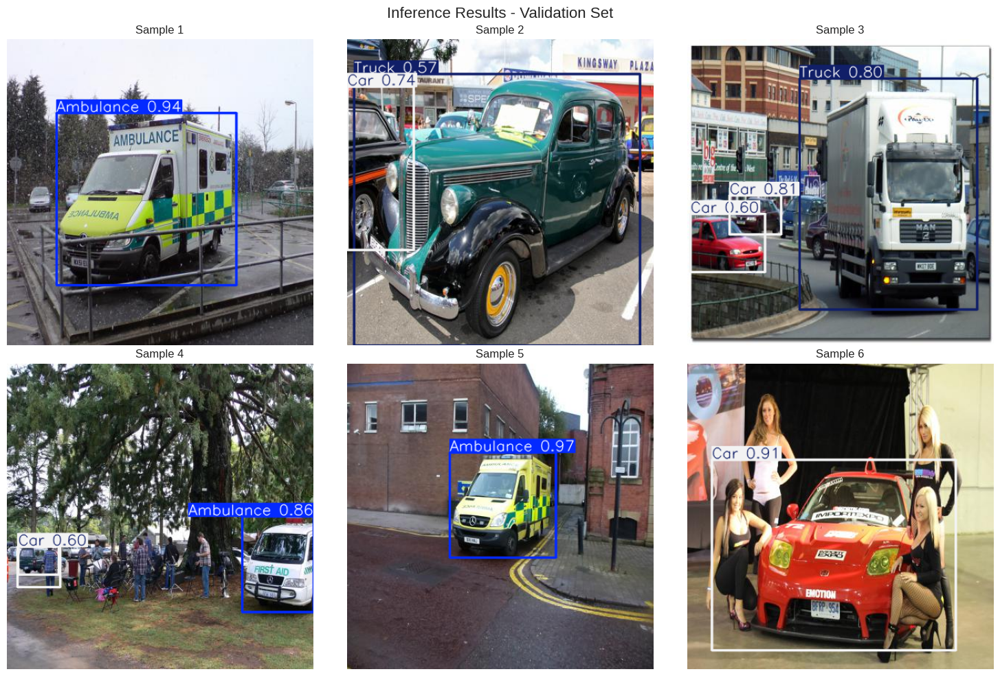

Running inference on 6 sample images from Test set...

image 1/1 /kaggle/input/vehicledetection/VehiclesDetectionDataset/test/images/d66aabbb1f7299cc_jpg.rf.27774c8e4188c1c8b62075beac6af14a.jpg: 800x800 2 Cars, 9.1ms
Speed: 3.2ms preprocess, 9.1ms inference, 1.4ms postprocess per image at shape (1, 3, 800, 800)

image 1/1 /kaggle/input/vehicledetection/VehiclesDetectionDataset/test/images/d66aabbb1f7299cc_jpg.rf.BmdIwlEED5bAslMh9Qib.jpg: 800x800 2 Cars, 8.6ms
Speed: 3.1ms preprocess, 8.6ms inference, 1.3ms postprocess per image at shape (1, 3, 800, 800)

image 1/1 /kaggle/input/vehicledetection/VehiclesDetectionDataset/test/images/9876c285fe7bc3a0_jpg.rf.7aa68726bc91a7c26d99c23dd79cc833.jpg: 800x800 1 Ambulance, 8.6ms
Speed: 3.1ms preprocess, 8.6ms inference, 1.3ms postprocess per image at shape (1, 3, 800, 800)

image 1/1 /kaggle/input/vehicledetection/VehiclesDetectionDataset/test/images/1ef77c61856d3b4b_jpg.rf.HZMSiUVx3WUcMIooJMZX.jpg: 800x800 1 Car, 9.1ms
Speed: 3.5ms preprocess, 9

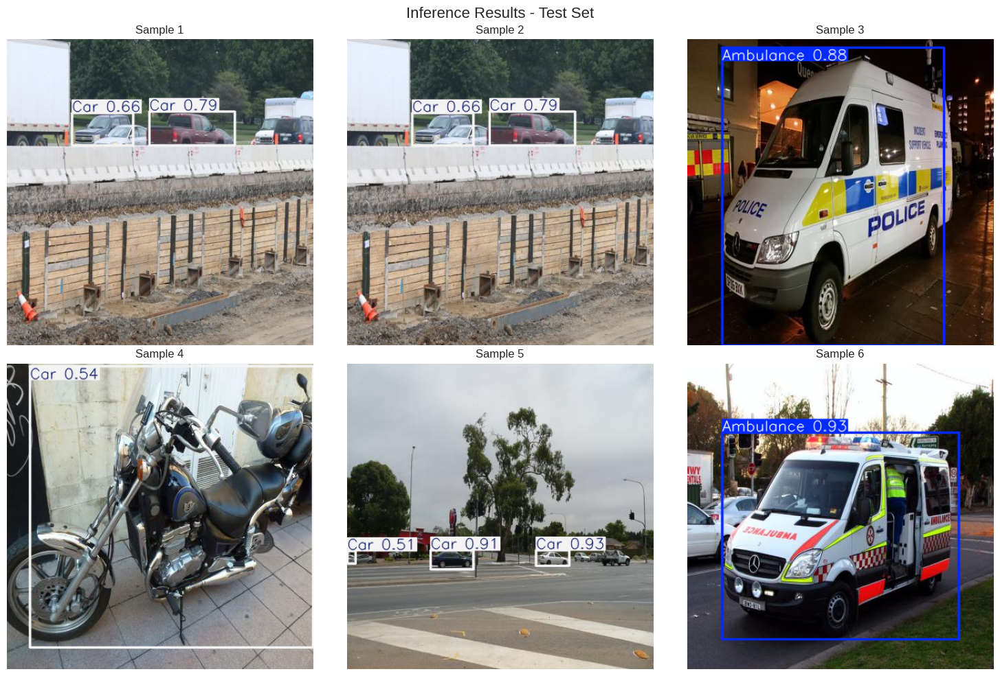

In [35]:
# Run inference on samples from each split
run_inference_on_samples(valid_images, "Validation", 6)
run_inference_on_samples(test_images, "Test", 6)

# Class-wise Performance Analysis

Let's analyze the performance of our model for each vehicle class.

In [36]:
def analyze_class_performance(validation_results, class_names):
    """Analyze performance metrics for each class"""
    if not hasattr(validation_results, 'box'):
        print("Validation results not available for class analysis")
        return
    
    box_results = validation_results.box
    
    # Check if class-wise metrics are available
    if hasattr(box_results, 'ap_class_index') and hasattr(box_results, 'ap'):
        class_indices = box_results.ap_class_index
        if len(box_results.ap.shape) > 1:
            class_ap50 = box_results.ap[:, 0]  # AP at IoU=0.5
            class_ap75 = box_results.ap[:, 5] if box_results.ap.shape[1] > 5 else None  # AP at IoU=0.75
        else:
            class_ap50 = box_results.ap
            class_ap75 = None
        
        print("Class-wise Performance Metrics:")
        print("-" * 50)
        print(f"{'Class':<12} {'AP@0.5':<8} {'AP@0.75':<8}")
        print("-" * 50)
        
        performance_data = []
        for i, class_idx in enumerate(class_indices):
            class_name = class_names.get(int(class_idx), f"Class_{class_idx}")
            ap50 = class_ap50[i] if i < len(class_ap50) else 0
            ap75 = class_ap75[i] if class_ap75 is not None and i < len(class_ap75) else 0
            
            print(f"{class_name:<12} {ap50:<8.3f} {ap75:<8.3f}")
            performance_data.append((class_name, ap50, ap75 if ap75 else 0))
        
        # Visualize class-wise performance
        if performance_data:
            classes, ap50_scores, ap75_scores = zip(*performance_data)
            
            plt.figure(figsize=(12, 6))
            
            x = np.arange(len(classes))
            width = 0.35
            
            bars1 = plt.bar(x - width/2, ap50_scores, width, label='AP@0.5', 
                          color=['#FF6B6B', '#4ECDC4', '#45B7D1', '#96CEB4', '#FECA57'])
            bars2 = plt.bar(x + width/2, ap75_scores, width, label='AP@0.75', 
                          color=['#FF6B6B', '#4ECDC4', '#45B7D1', '#96CEB4', '#FECA57'], alpha=0.7)
            
            plt.title('Class-wise Average Precision')
            plt.xlabel('Vehicle Class')
            plt.ylabel('Average Precision')
            plt.xticks(x, classes, rotation=45)
            plt.ylim(0, 1)
            plt.legend()
            
            # Add value labels on bars
            for bar, score in zip(bars1, ap50_scores):
                plt.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.01,
                        f'{score:.3f}', ha='center', va='bottom', fontsize=8)
            
            for bar, score in zip(bars2, ap75_scores):
                plt.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.01,
                        f'{score:.3f}', ha='center', va='bottom', fontsize=8)
            
            plt.tight_layout()
            plt.show()
    else:
        print("Class-wise AP metrics not available")
        
    # Display overall metrics
    print(f"\nOverall Performance:")
    print(f"mAP@0.5: {box_results.map50:.4f}")
    print(f"mAP@0.5-0.95: {box_results.map:.4f}")
    print(f"Precision: {box_results.mp:.4f}")
    print(f"Recall: {box_results.mr:.4f}")
    print(f"F1-Score: {box_results.f1}")

Class-wise Performance Metrics:
--------------------------------------------------
Class        AP@0.5   AP@0.75 
--------------------------------------------------
Ambulance    0.630    0.000   
Bus          0.403    0.000   
Car          0.271    0.000   
Motorcycle   0.217    0.000   
Truck        0.244    0.000   


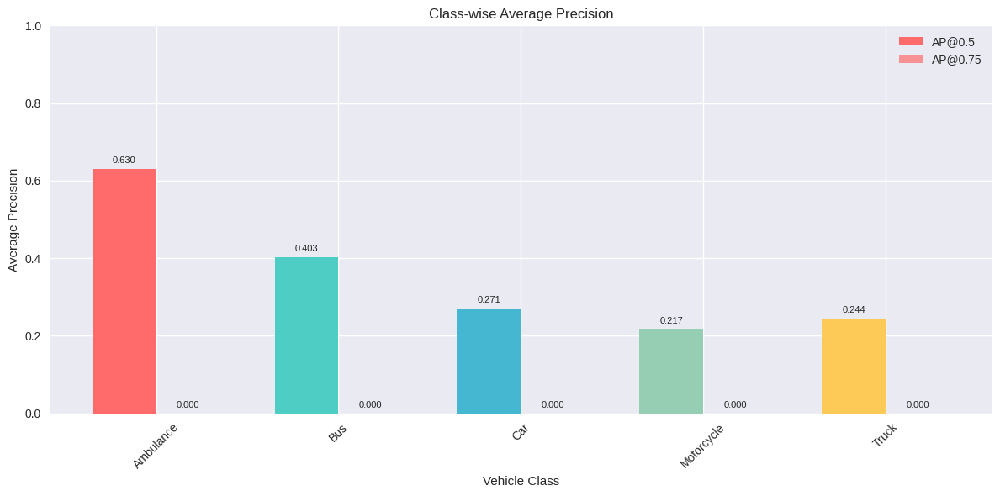


Overall Performance:
mAP@0.5: 0.5155
mAP@0.5-0.95: 0.3532
Precision: 0.6171
Recall: 0.4557
F1-Score: [    0.65411     0.53539     0.47415     0.42084     0.48112]


In [37]:
# Analyze class performance on validation results
analyze_class_performance(val_results, CLASS_NAMES)

# Model Export and Deployment

Let's export our trained model in different formats for deployment.

In [38]:
print("Exporting model to different formats for deployment...")

# Export model to different formats
export_formats = ['onnx', 'torchscript']
exported_models = {}

for format_type in export_formats:
    try:
        print(f"\nExporting to {format_type.upper()}...")
        exported_path = best_model.export(format=format_type, dynamic=False, simplify=True)
        exported_models[format_type] = exported_path
        print(f"Successfully exported to {format_type.upper()}: {exported_path}")
    except Exception as e:
        print(f"Failed to export to {format_type.upper()}: {e}")

Exporting model to different formats for deployment...

Exporting to ONNX...
Ultralytics 8.3.199 🚀 Python-3.11.11 torch-2.6.0+cu124 CPU (Intel Xeon CPU @ 2.00GHz)
💡 ProTip: Export to OpenVINO format for best performance on Intel hardware. Learn more at https://docs.ultralytics.com/integrations/openvino/

PyTorch: starting from '/kaggle/working/vehicle_detection_yolo11/weights/best.pt' with input shape (1, 3, 800, 800) BCHW and output shape(s) (1, 9, 13125) (5.2 MB)
requirements: Ultralytics requirements ['onnxslim>=0.1.67', 'onnxruntime-gpu'] not found, attempting AutoUpdate...

requirements: AutoUpdate success ✅ 4.1s
WARNING ⚠️ requirements: Restart runtime or rerun command for updates to take effect


ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.68...
ONNX: export success ✅ 6.4s, saved as '/kaggle/working/vehicle_detection_yolo11/weights/best.onnx' (10.2 MB)

Export complete (6.8s)
Results saved to /kaggle/working/vehicle_detection_yolo11/weight

In [39]:
# Try additional formats if possible
additional_formats = ['engine', 'coreml']
for format_type in additional_formats:
    try:
        print(f"\nTrying to export to {format_type.upper()}...")
        exported_path = best_model.export(format=format_type)
        exported_models[format_type] = exported_path
        print(f"Successfully exported to {format_type.upper()}: {exported_path}")
    except Exception as e:
        print(f"Could not export to {format_type.upper()}: {e}")

print(f"\nSuccessfully exported formats: {list(exported_models.keys())}")


Trying to export to ENGINE...
WARNING ⚠️ TensorRT requires GPU export, automatically assigning device=0
Ultralytics 8.3.199 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)

PyTorch: starting from '/kaggle/working/vehicle_detection_yolo11/weights/best.pt' with input shape (1, 3, 800, 800) BCHW and output shape(s) (1, 9, 13125) (5.2 MB)

ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.68...
ONNX: export success ✅ 2.0s, saved as '/kaggle/working/vehicle_detection_yolo11/weights/best.onnx' (10.2 MB)
requirements: Ultralytics requirement ['tensorrt-cu12>7.0.0,!=10.1.0'] not found, attempting AutoUpdate...

requirements: AutoUpdate success ✅ 38.0s
WARNING ⚠️ requirements: Restart runtime or rerun command for updates to take effect


TensorRT: starting export with TensorRT 10.13.3.9...
[09/14/2025-05:06:22] [TRT] [I] [MemUsageChange] Init CUDA: CPU -1, GPU +0, now: CPU 3177, GPU 2834 (MiB)
[09/14/2025-05:06:23] [TRT] [I] [MemUsag

E0000 00:00:1757826386.387595      19 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1757826386.440513      19 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered



CoreML: starting export with coremltools 9.0b1...


Running MIL backend_mlprogram pipeline: 100%|██████████| 12/12 [00:00<00:00, 87.43 passes/s]


CoreML: export success ✅ 27.3s, saved as '/kaggle/working/vehicle_detection_yolo11/weights/best.mlpackage' (5.2 MB)

Export complete (27.6s)
Results saved to /kaggle/working/vehicle_detection_yolo11/weights
Predict:         yolo predict task=detect model=/kaggle/working/vehicle_detection_yolo11/weights/best.mlpackage imgsz=800  
Validate:        yolo val task=detect model=/kaggle/working/vehicle_detection_yolo11/weights/best.mlpackage imgsz=800 data=/kaggle/working/yolo11_dataset.yaml  
Visualize:       https://netron.app
Successfully exported to COREML: /kaggle/working/vehicle_detection_yolo11/weights/best.mlpackage

Successfully exported formats: ['onnx', 'torchscript', 'coreml']


# Model Performance Summary

Let's create a comprehensive summary of our model's performance and training results.

In [40]:
# Collect performance metrics
performance_summary = {
    'Dataset Statistics': {
        'Total Images': total_images,
        'Training Images': train_count,
        'Validation Images': valid_count,
        'Test Images': test_count,
        'Total Objects': sum(total_class_counts.values()),
        'Classes': len(CLASS_NAMES)
    },
    'Training Configuration': {
        'Model': 'YOLOv11n',
        'Epochs': EPOCHS,
        'Batch Size': BATCH_SIZE,
        'Image Size': IMAGE_SIZE,
        'Learning Rate': LEARNING_RATE,
        'Device': 'GPU' if torch.cuda.is_available() else 'CPU'
    },
    'Class Distribution': {}
}

In [41]:
# Add class distribution to summary
for class_id, count in sorted(total_class_counts.items()):
    class_name = CLASS_NAMES.get(class_id, f"Class_{class_id}")
    percentage = (count / sum(total_class_counts.values())) * 100
    performance_summary['Class Distribution'][class_name] = f"{count} ({percentage:.1f}%)"

In [42]:
# Add validation metrics if available
if hasattr(val_results, 'box'):
    performance_summary['Validation Metrics'] = {
        'mAP@0.5': f"{val_results.box.map50:.4f}",
        'mAP@0.5-0.95': f"{val_results.box.map:.4f}",
        'Precision': f"{val_results.box.mp:.4f}",
        'Recall': f"{val_results.box.mr:.4f}",
        'F1-Score': f"{val_results.box.f1}"
    }

In [43]:
# Add test metrics if available
if 'test_results' in locals() and hasattr(test_results, 'box'):
    performance_summary['Test Metrics'] = {
        'mAP@0.5': f"{test_results.box.map50:.4f}",
        'mAP@0.5-0.95': f"{test_results.box.map:.4f}",
        'Precision': f"{test_results.box.mp:.4f}",
        'Recall': f"{test_results.box.mr:.4f}",
        'F1-Score': f"{test_results.box.f1}"
    }

In [44]:
# Display comprehensive summary
print("=" * 80)
print("VEHICLE DETECTION MODEL - PERFORMANCE SUMMARY")
print("=" * 80)

for section, metrics in performance_summary.items():
    print(f"\n{section}:")
    print("-" * len(section))
    for key, value in metrics.items():
        print(f"  {key}: {value}")

print(f"\nModel Files:")
print("-" * 50)
print(f"  Best Weights: {best_model_path}")
print(f"  Training Results: {results_path}")
print(f"  Dataset Config: {config_path}")

VEHICLE DETECTION MODEL - PERFORMANCE SUMMARY

Dataset Statistics:
------------------
  Total Images: 1254
  Training Images: 878
  Validation Images: 250
  Test Images: 126
  Total Objects: 2388
  Classes: 5

Training Configuration:
----------------------
  Model: YOLOv11n
  Epochs: 500
  Batch Size: 32
  Image Size: 800
  Learning Rate: 0.001
  Device: GPU

Class Distribution:
------------------
  Ambulance: 252 (10.6%)
  Bus: 282 (11.8%)
  Car: 1302 (54.5%)
  Motorcycle: 280 (11.7%)
  Truck: 272 (11.4%)

Validation Metrics:
------------------
  mAP@0.5: 0.5155
  mAP@0.5-0.95: 0.3532
  Precision: 0.6171
  Recall: 0.4557
  F1-Score: [    0.65411     0.53539     0.47415     0.42084     0.48112]

Test Metrics:
------------
  mAP@0.5: 0.6541
  mAP@0.5-0.95: 0.4580
  Precision: 0.6566
  Recall: 0.5761
  F1-Score: [    0.72264     0.70677     0.63689     0.27975     0.59659]

Model Files:
--------------------------------------------------
  Best Weights: /kaggle/working/vehicle_detection_y

In [45]:
if exported_models:
    print(f"\nExported Models:")
    print("-" * 50)
    for format_type, path in exported_models.items():
        print(f"  {format_type.upper()}: {path}")

print(f"\nClass Names Mapping:")
print("-" * 50)
for class_id, class_name in CLASS_NAMES.items():
    print(f"  {class_id}: {class_name}")


Exported Models:
--------------------------------------------------
  ONNX: /kaggle/working/vehicle_detection_yolo11/weights/best.onnx
  TORCHSCRIPT: /kaggle/working/vehicle_detection_yolo11/weights/best.torchscript
  COREML: /kaggle/working/vehicle_detection_yolo11/weights/best.mlpackage

Class Names Mapping:
--------------------------------------------------
  0: Ambulance
  1: Bus
  2: Car
  3: Motorcycle
  4: Truck


# Using the Model on the real data

Let's see the performance of our model in a real Video. 

In [46]:
# Model and video paths
MODEL_PATH = "/kaggle/working/vehicle_detection_yolo11/weights/best.pt"
VIDEO_PATH = "/kaggle/input/vehicledetection/TestVideo/TrafficPolice.mp4"

OUTPUT_PATH = "/kaggle/working/output_vehicle_detection.mp4"
COMPRESSED_OUTPUT_PATH = "/kaggle/working/compressed_vehicle_detection.mp4"

# Processing settings
CONFIDENCE_THRESHOLD = 0.5
DURATION_SECONDS = 93 
COMPRESSION_CRF = 30  # Lower = better quality, higher file size

In [47]:
# Load YOLO model
model = YOLO(MODEL_PATH)

# Setup annotators
box_annotator = sv.BoxAnnotator(
    thickness=2
)
label_annotator = sv.LabelAnnotator(
    text_thickness=1,
    text_scale=0.5,
    text_padding=5
)

In [48]:
# Video setup
cap = cv2.VideoCapture(VIDEO_PATH)

if not cap.isOpened():
    print("Error: Could not open video file")
    print("Please check the video path in the configuration section")
    exit()

# Get video properties
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

print(f"Video Info:")
print(f"Resolution: {frame_width}x{frame_height}")
print(f"FPS: {fps}")
print(f"Total Frames: {total_frames}")
print(f"Duration: {total_frames/fps:.1f} seconds")

Video Info:
Resolution: 1280x720
FPS: 25
Total Frames: 2362
Duration: 94.5 seconds


In [49]:
# Calculate processing limits
max_frames = int(fps * DURATION_SECONDS)
max_frames = min(max_frames, total_frames)  # Don't exceed video length

print(f"Will process first {DURATION_SECONDS} seconds ({max_frames} frames)")

# Jump to start of video
cap.set(cv2.CAP_PROP_POS_FRAMES, 0)

Will process first 93 seconds (2325 frames)


True

In [50]:
# Setup video writer
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(OUTPUT_PATH, fourcc, fps, (frame_width, frame_height))

if not out.isOpened():
    print("Error: Could not create output video writer")
    cap.release()
    exit()

In [51]:
# Processing loop
frame_count = 0
detection_stats = {}

try:
    while cap.isOpened() and frame_count < max_frames:
        ret, frame = cap.read()
        if not ret:
            print("End of video reached")
            break

        frame_count += 1
        
        # Run YOLO detection
        results = model(frame, conf=CONFIDENCE_THRESHOLD, verbose=False)[0]
        detections = sv.Detections.from_ultralytics(results)
        
        # Count detections by class
        if len(detections) > 0:
            for class_id in detections.class_id:
                class_name = model.names[class_id]
                detection_stats[class_name] = detection_stats.get(class_name, 0) + 1

        # Annotate frame
        annotated_frame = box_annotator.annotate(
            scene=frame.copy(), 
            detections=detections
        )
        annotated_frame = label_annotator.annotate(
            scene=annotated_frame, 
            detections=detections,
            labels=[f"{model.names[class_id]} {confidence:.2f}" 
                   for class_id, confidence in zip(detections.class_id, detections.confidence)]
        )
        
        # Add frame info overlay
        info_text = f"Frame: {frame_count}/{max_frames} | Detections: {len(detections)}"
        cv2.putText(annotated_frame, info_text, (10, 30), 
                   cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255, 255, 255), 2)

        # Add progress bar
        progress = frame_count / max_frames
        bar_width = 300
        bar_height = 8
        bar_x, bar_y = 10, frame_height - 40
        
        # Background bar
        cv2.rectangle(annotated_frame, (bar_x, bar_y), 
                     (bar_x + bar_width, bar_y + bar_height), (50, 50, 50), -1)
        # Progress bar
        cv2.rectangle(annotated_frame, (bar_x, bar_y), 
                     (bar_x + int(bar_width * progress), bar_y + bar_height), (0, 255, 0), -1)
        
        # Write frame to output video
        out.write(annotated_frame)
        
        # Print progress every 30 frames (roughly every second)
        if frame_count % 30 == 0 or frame_count == max_frames:
            print(f"Progress: {progress*100:.1f}% - Frame {frame_count}/{max_frames} - "
                  f"Current detections: {len(detections)}")

except KeyboardInterrupt:
    print("Processing interrupted by user")

finally:
    # Cleanup
    cap.release()
    out.release()
    print("Video processing complete!")

Progress: 1.3% - Frame 30/2325 - Current detections: 1
Progress: 2.6% - Frame 60/2325 - Current detections: 1
Progress: 3.9% - Frame 90/2325 - Current detections: 1
Progress: 5.2% - Frame 120/2325 - Current detections: 2
Progress: 6.5% - Frame 150/2325 - Current detections: 3
Progress: 7.7% - Frame 180/2325 - Current detections: 1
Progress: 9.0% - Frame 210/2325 - Current detections: 0
Progress: 10.3% - Frame 240/2325 - Current detections: 2
Progress: 11.6% - Frame 270/2325 - Current detections: 0
Progress: 12.9% - Frame 300/2325 - Current detections: 2
Progress: 14.2% - Frame 330/2325 - Current detections: 3
Progress: 15.5% - Frame 360/2325 - Current detections: 0
Progress: 16.8% - Frame 390/2325 - Current detections: 2
Progress: 18.1% - Frame 420/2325 - Current detections: 1
Progress: 19.4% - Frame 450/2325 - Current detections: 0
Progress: 20.6% - Frame 480/2325 - Current detections: 2
Progress: 21.9% - Frame 510/2325 - Current detections: 4
Progress: 23.2% - Frame 540/2325 - Curren

In [52]:
# Print detection statistics
print("DETECTION STATISTICS")
print(f"Frames Processed: {frame_count}")
print(f"Duration Processed: {frame_count/fps:.1f} seconds")

if detection_stats:
    print(f"Detected Vehicles:")
    for vehicle_type, count in sorted(detection_stats.items(), key=lambda x: x[1], reverse=True):
        print(f"   {vehicle_type}: {count} detections")
    print(f"Total Detections: {sum(detection_stats.values())}")
else:
    print("No vehicles detected in the processed video")

DETECTION STATISTICS
Frames Processed: 2325
Duration Processed: 93.0 seconds
Detected Vehicles:
   Car: 2848 detections
   Motorcycle: 424 detections
   Ambulance: 368 detections
   Truck: 210 detections
   Bus: 2 detections
Total Detections: 3852


In [53]:
# Compress video using FFmpeg
print(f"Compressing video...")
print(f"Input: {OUTPUT_PATH}")
print(f"Output: {COMPRESSED_OUTPUT_PATH}")

# FFmpeg compression command
ffmpeg_cmd = [
    "ffmpeg", "-y", "-i", OUTPUT_PATH,
    "-vcodec", "libx264",
    "-crf", str(COMPRESSION_CRF),
    "-preset", "fast",
    COMPRESSED_OUTPUT_PATH
]

try:
    result = subprocess.run(ffmpeg_cmd, stdout=subprocess.DEVNULL, stderr=subprocess.DEVNULL)
    if result.returncode == 0:
        # Get file sizes for comparison
        original_size = os.path.getsize(OUTPUT_PATH) / (1024 * 1024)  # MB
        compressed_size = os.path.getsize(COMPRESSED_OUTPUT_PATH) / (1024 * 1024)  # MB
        compression_ratio = (1 - compressed_size / original_size) * 100
    else:
        print("Video compression failed!")
except Exception as e:
    print(f"Error during compression: {e}")

Compressing video...
Input: /kaggle/working/output_vehicle_detection.mp4
Output: /kaggle/working/compressed_vehicle_detection.mp4


In [54]:
# Display the compressed video preview
try:
    if os.path.exists(COMPRESSED_OUTPUT_PATH):
        display(Video(COMPRESSED_OUTPUT_PATH, embed=True))
    else:
        print("Compressed video file not found")
        if os.path.exists(OUTPUT_PATH):
            print("Displaying original video instead...")
            display(Video(OUTPUT_PATH, embed=True))
except Exception as e:
    print(f"Error displaying video: {e}")